# Replay flight tracks on a map and save animation as a mp4 movie

In [1]:
%load_ext lab_black
%matplotlib inline

In [2]:
from datetime import datetime, timedelta
import pandas as pd
import geopandas as gpd
import movingpandas as mpd
import contextily as ctx
import io
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import matplotlib.animation as animation
from matplotlib.animation import FFMpegFileWriter
from scipy import ndimage
from IPython.display import HTML

import warnings

warnings.filterwarnings("ignore")

In [3]:
tile_zoom = 6  # map tile zoom for contextily
figsize = (15, 15)
plane_icon_path = "http://maps.google.com/mapfiles/kml/shapes/airports.png"
icon_zoom = 0.3  # zoom of plane icon
step = 60  # duration between two positions in seconds
fps = 2  # 2 frames per second

#### Build trajectory with pandas, geopandas, movingpandas

In [4]:
df = pd.read_csv(
    "marrakesh-rome.csv", index_col=0, infer_datetime_format=True, parse_dates=True
)
gdf = gpd.GeoDataFrame(
    df,
    geometry=gpd.points_from_xy(df.longitude, df.latitude),
    crs={"init": "epsg:4326"},  # WGS84
)
gdf = gdf.to_crs({"init": "epsg:3857"})  # projection to Web Mercator
traj = mpd.Trajectory(gdf, "Marrakesh-Rome")
traj.add_speed(overwrite=True)
traj.add_direction(overwrite=True)
print(traj)

Trajectory Marrakesh-Rome (2018-03-01 10:56:00 to 2018-03-01 13:31:41) | Size: 89 | Length: 2829137.3m
Bounds: (-895101.4722202459, 3712043.6946871723, 1401728.844271187, 5152702.693355908)
LINESTRING (-895101.4722202459 3712043.694687172, -893493.5234014592 3713931.882529974, -889906.5626


#### Load background map with contextily

In [5]:
w, s, e, n = gdf.total_bounds
bck, ext = ctx.bounds2img(w, s, e, n, tile_zoom, ll=False)

#### Function to interpolate direction at a given time of the trajectory (movingpandas style)

In [6]:
def interpolate_direction_at(traj, t):
    if t in traj.df.index:
        return traj.df.loc[t].direction
    if t == traj.get_start_time():
        return traj.df.iloc[0].direction

    prev_row = traj.get_row_at(t, "ffill")
    next_row = traj.get_row_at(t, "bfill")
    t_diff = next_row.name - prev_row.name
    t_diff_at = t - prev_row.name
    return prev_row.direction + (
        (next_row.direction - prev_row.direction) * (t_diff_at / t_diff)
    )

#### Load images for each datetime

In [7]:
def fig2img(fig):
    buf = io.BytesIO()
    fig.savefig(buf, bbox_inches="tight", pad_inches=-0.1)
    buf.seek(0)
    img = Image.open(buf)
    return img

In [8]:
t = traj.get_start_time()
ims = []
plane = plt.imread(plane_icon_path)
f, ax = plt.subplots(figsize=figsize)
ax.imshow(bck, extent=ext, interpolation="sinc", aspect="equal")
ab = None
index = 0
while t <= traj.get_end_time():
    if ab != None:
        ab.remove()
    pos = traj.get_position_at(t)
    direction = interpolate_direction_at(traj, t)
    r_plane = ndimage.rotate(plane, 360 - direction, order=1)
    ab = AnnotationBbox(
        OffsetImage(r_plane, zoom=icon_zoom), (pos.x, pos.y), frameon=False,
    )
    ax.add_artist(ab)
    ax.set_axis_off()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ims.append([fig2img(f)])
    plt.close(f)
    t += timedelta(seconds=step)

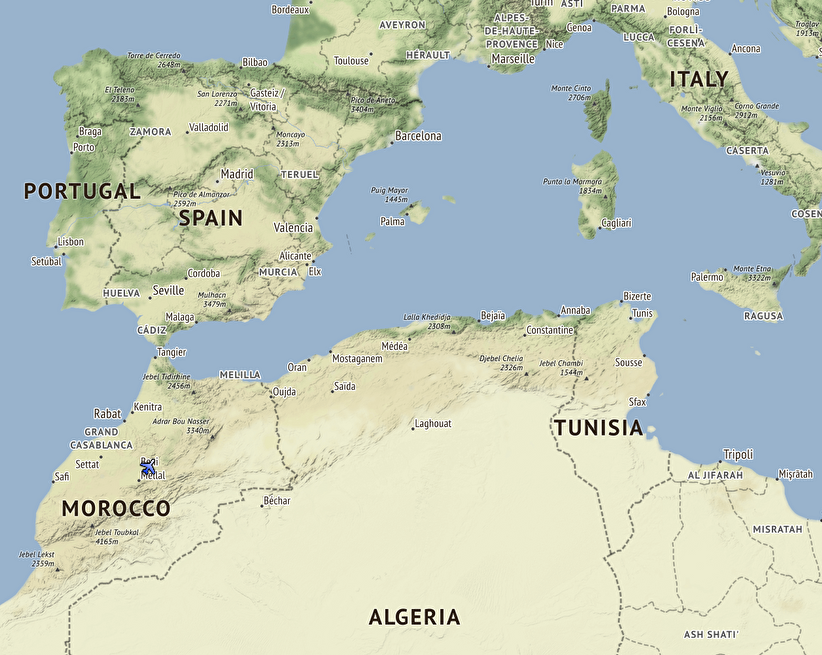

In [9]:
ims[20][0]

#### Build animation

In [10]:
fig = plt.figure(figsize=figsize)

img_list = [plt.imshow(im[0], animated=True) for im in ims]
img_list = []
for im in ims:
    im2 = plt.imshow(im[0], animated=True)
    img_list.append([im2])

plt.axis("off")

ani = animation.ArtistAnimation(fig, img_list, interval=1000 / fps, blit=True)
plt.close(fig)
HTML(ani.to_jshtml())

Animation size has reached 21315668 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


#### Save animation as mp4 video

In [11]:
mywriter = FFMpegFileWriter(fps=fps)
ani.save("flight.mp4", writer=mywriter)